In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import tensorflow_datasets as tfds
import tensorflow_hub as hub
import os
from google.colab import drive

In [2]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
vgg19 = tf.keras.applications.VGG19(include_top=False)
vgg19.trainable = False

In [4]:
def image_path_to_tensor(img_path, img_size = (512, 512)):
  image = tf.io.read_file(img_path)
  image = tf.image.decode_image(image, channels=3)
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, img_size)
  return image

In [5]:
def loss_function(preprocessed_content, preprocessed_style, target_img, alpha=1e-2, beta=1e-2):
  
  content_layers = ['block5_conv2'] 
  style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

  content_model = tf.keras.Model([vgg19.input], [vgg19.get_layer(layer).output for layer in content_layers])
  style_model = tf.keras.Model([vgg19.input], [vgg19.get_layer(layer).output for layer in style_layers])

  preprocessed_target = tf.keras.applications.vgg19.preprocess_input(target_img*255)
  
  content_features = content_model(tf.expand_dims(preprocessed_content, axis=0))
  target_content_features = content_model(tf.expand_dims(preprocessed_target, axis=0))

  style_features = style_model(tf.expand_dims(preprocessed_style, axis=0))
  target_style_features = style_model(tf.expand_dims(preprocessed_target, axis=0))

  content_loss = tf.math.reduce_mean(tf.math.square(target_content_features - content_features))

  E = []
  for l in range(len(style_features)):
    N = style_features[l].shape[-1]
    M = tf.math.reduce_prod(style_features[l].shape[:-1]).numpy()
    style_features_reshaped = tf.reshape(style_features[l], [M, N])
    A = tf.matmul(style_features_reshaped, style_features_reshaped, transpose_a=True)
    target_style_features_reshaped = tf.reshape(target_style_features[l], [M, N])
    G = tf.matmul(target_style_features_reshaped, target_style_features_reshaped, transpose_a=True)
    E.append(tf.math.reduce_mean(tf.math.square(G - A)))
  style_loss = sum(E) / len(E)

  total_loss = alpha * content_loss + beta * style_loss
  return total_loss

In [6]:
def vgg19_neural_style_transfer(content_img, style_img,
                                img_size = (512, 512),
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14,
                                show_image = True):
  
  tf.random.set_seed(seed)
  if initialization == 'random':
    target_img = tf.Variable(tf.random.uniform(tf.concat([img_size, [3]], 0)))
  elif initialization == 'content':
    target_img = tf.Variable(content_img)
  else:
    raise ValueError("initialization parameter must be 'random' or 'content'")

  preprocessed_content = tf.keras.applications.vgg19.preprocess_input(content_img*255)
  preprocessed_style = tf.keras.applications.vgg19.preprocess_input(style_img*255)

  for i in range(steps):
    with tf.GradientTape() as tape:
      loss = loss_function(preprocessed_content, preprocessed_style, target_img, alpha, beta)
    grad = tape.gradient(loss, target_img)
    opt.apply_gradients([(grad, target_img)])
    target_img.assign(tf.clip_by_value(target_img, 0.0, 1.0))

  if show_image:
    plt.figure(figsize = (8, 8))
    plt.imshow(target_img.numpy())
    plt.axis('off')
  
  return target_img

In [7]:
almamater = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Alma Mater.jpg')
columbia = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Columbia.jpg')
simpson = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Simpson.jpg')
pollock = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Pollock.jpg')

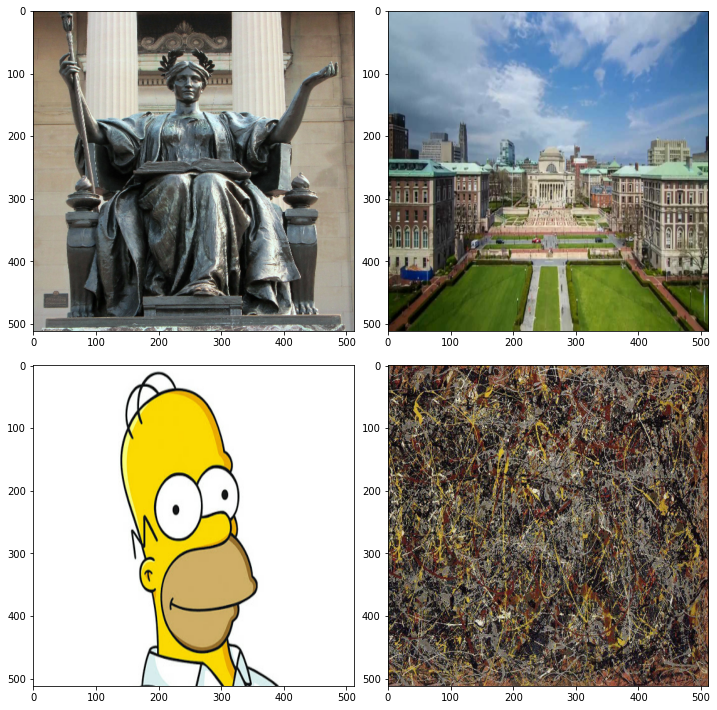

In [8]:
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(almamater.numpy())
ax[0, 1].imshow(columbia.numpy())
ax[1, 0].imshow(simpson.numpy())
ax[1, 1].imshow(pollock.numpy())
plt.tight_layout()

### Main Output

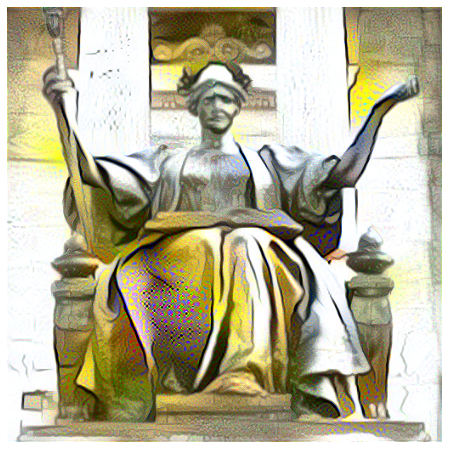

In [9]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

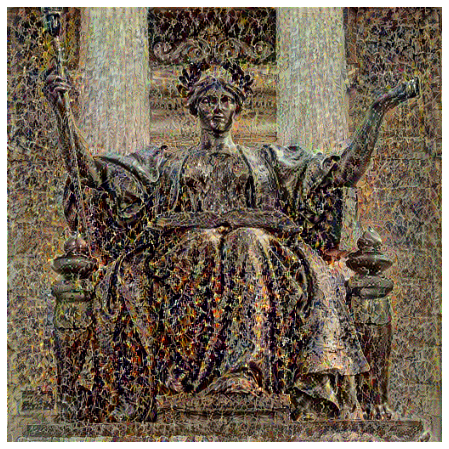

In [10]:
target = vgg19_neural_style_transfer(almamater, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

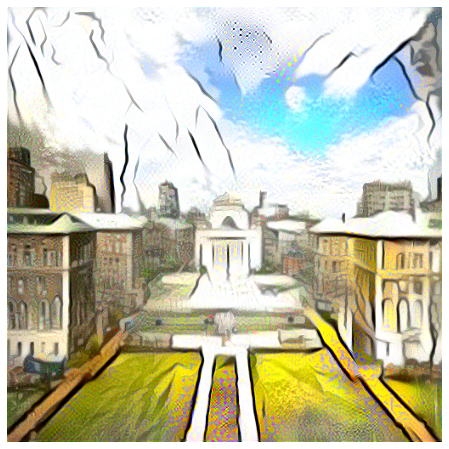

In [11]:
target = vgg19_neural_style_transfer(columbia, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

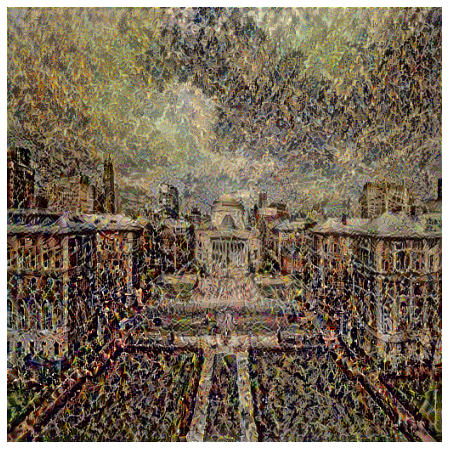

In [12]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

### Training Iterations (10, 25, 50, 75, 100)

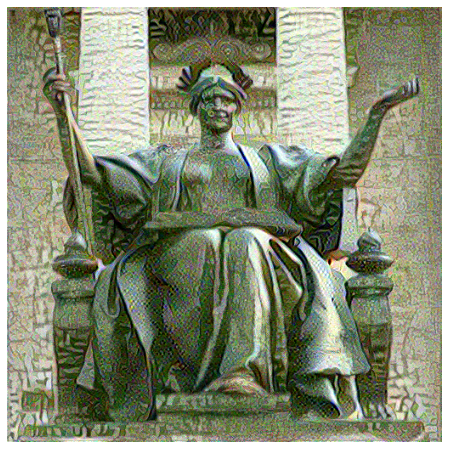

In [13]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 10, 
                                alpha = 1, 
                                beta = 1e-14)

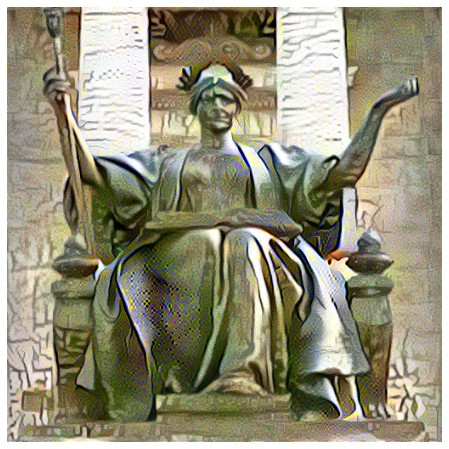

In [14]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 25, 
                                alpha = 1, 
                                beta = 1e-14)

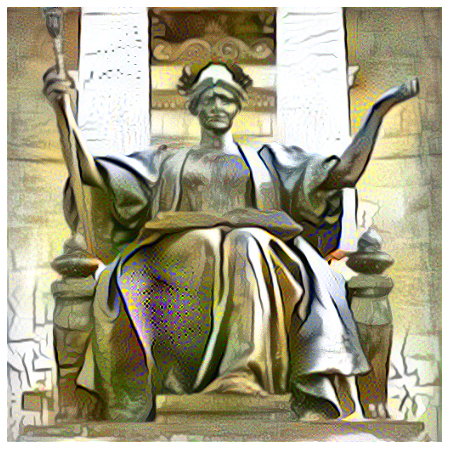

In [15]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 50, 
                                alpha = 1, 
                                beta = 1e-14)

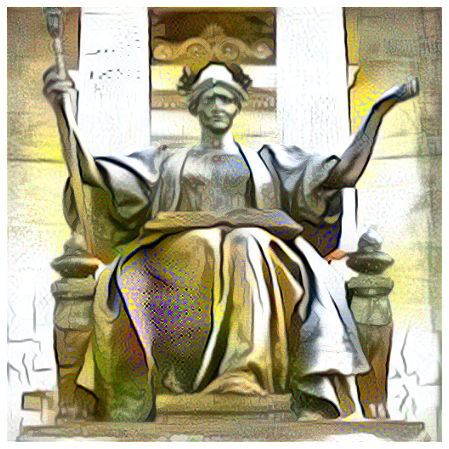

In [16]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 75, 
                                alpha = 1, 
                                beta = 1e-14)

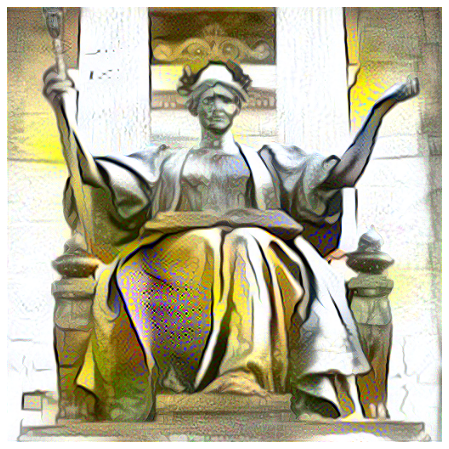

In [17]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

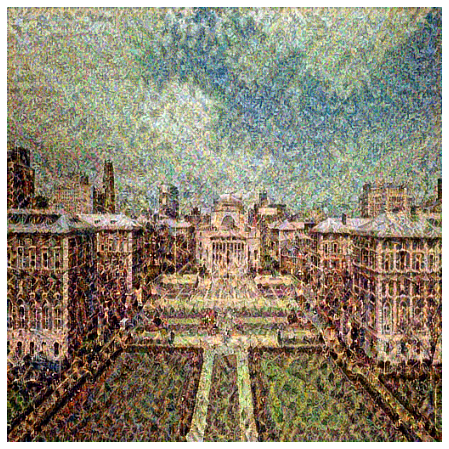

In [18]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 10, 
                                alpha = 1, 
                                beta = 1e-14)

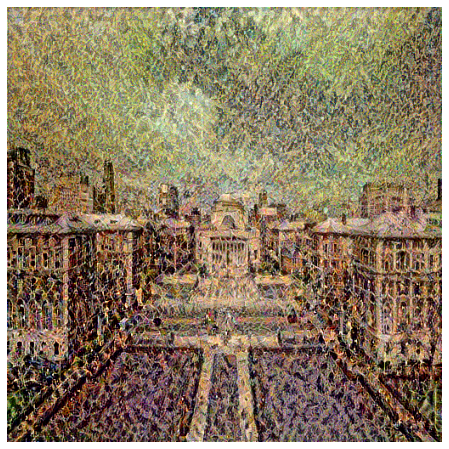

In [19]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 25, 
                                alpha = 1, 
                                beta = 1e-14)

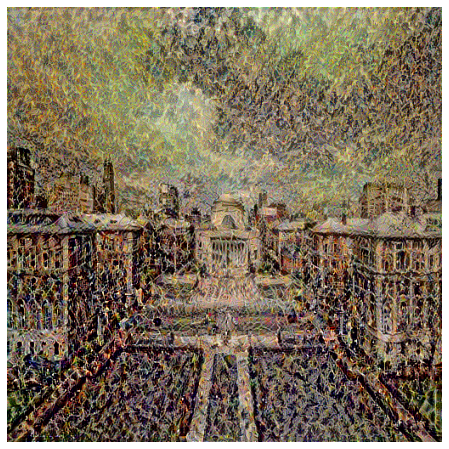

In [20]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 50, 
                                alpha = 1, 
                                beta = 1e-14)

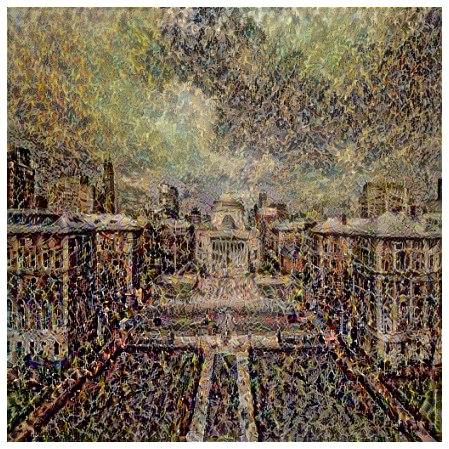

In [21]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 75, 
                                alpha = 1, 
                                beta = 1e-14)

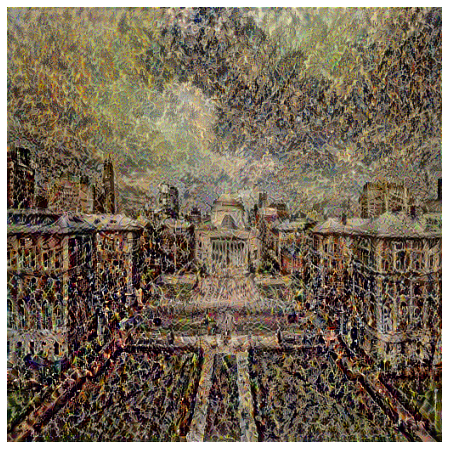

In [22]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

### Initializations (content, random seed 0, random seed 1)

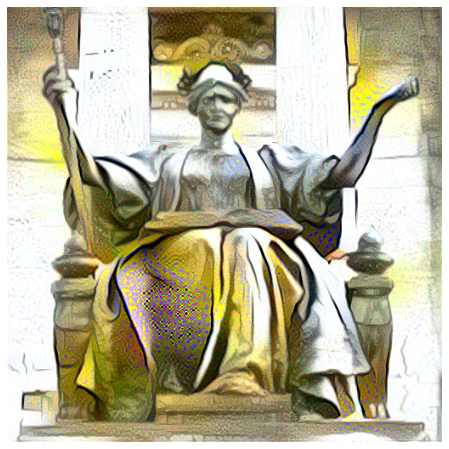

In [23]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

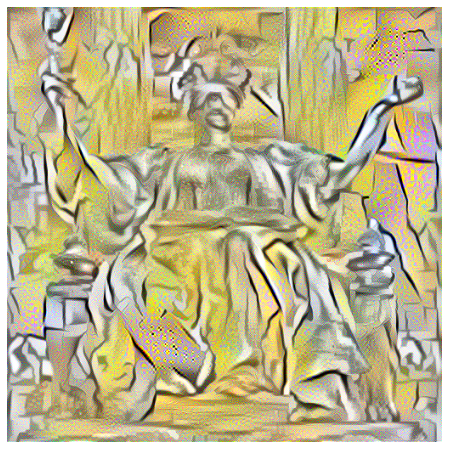

In [24]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

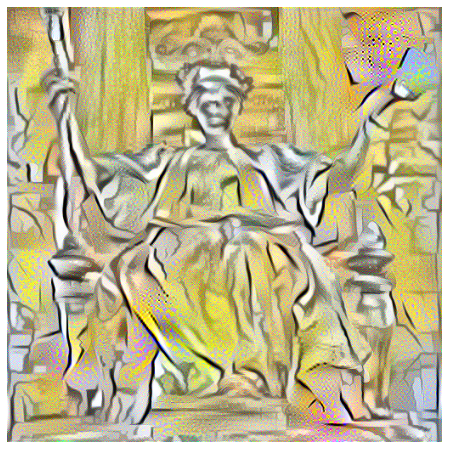

In [25]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 1,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

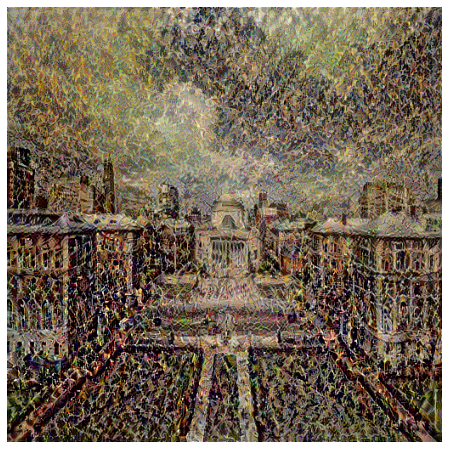

In [26]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

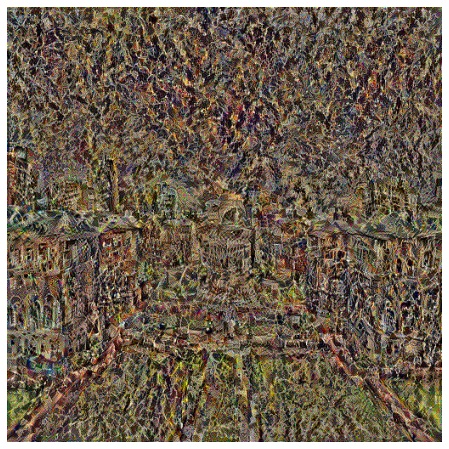

In [27]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

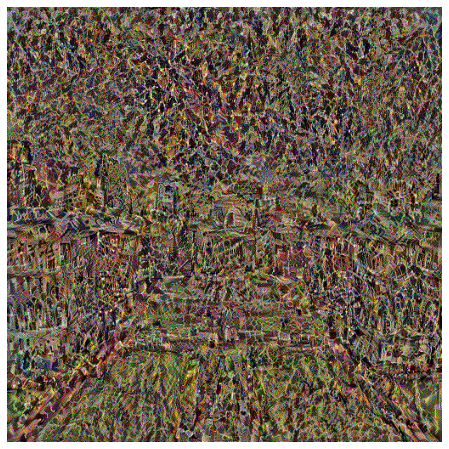

In [28]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 1,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

### Content loss vs. style loss weights (1e-13, 1e-14, 1e-15)

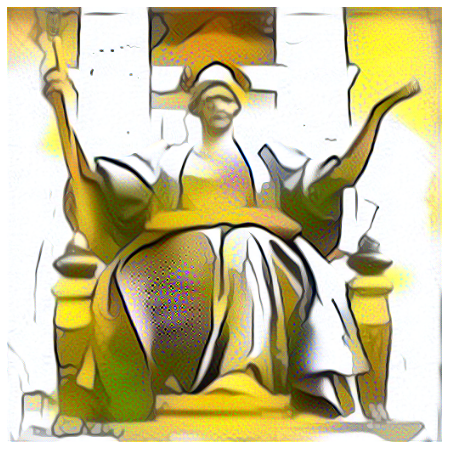

In [29]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-13)

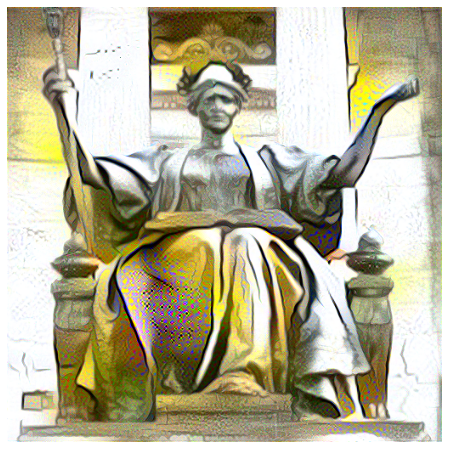

In [30]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

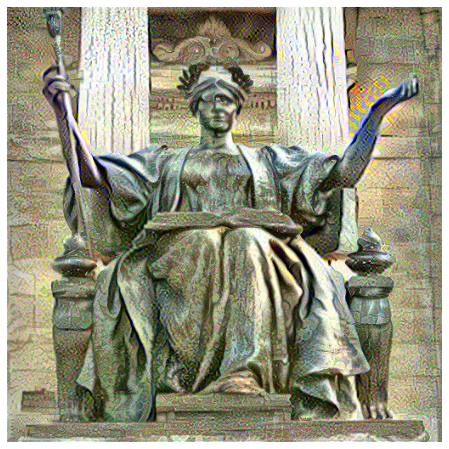

In [31]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-15)

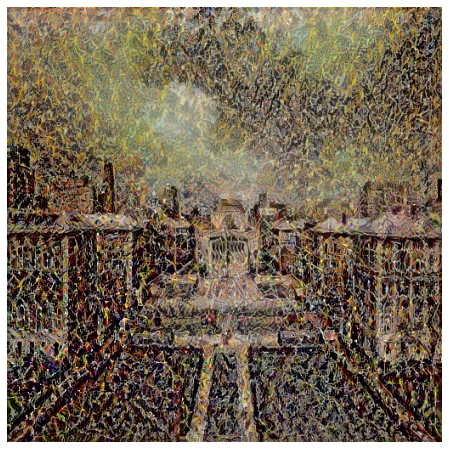

In [32]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-13)

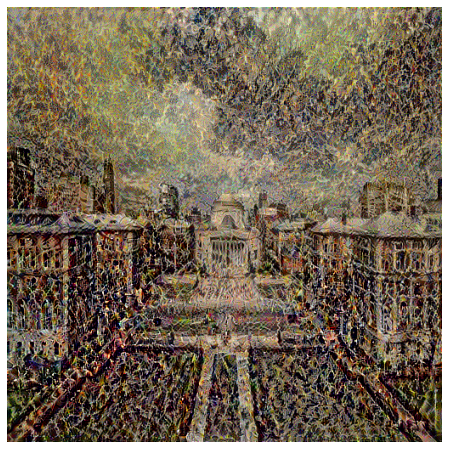

In [33]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

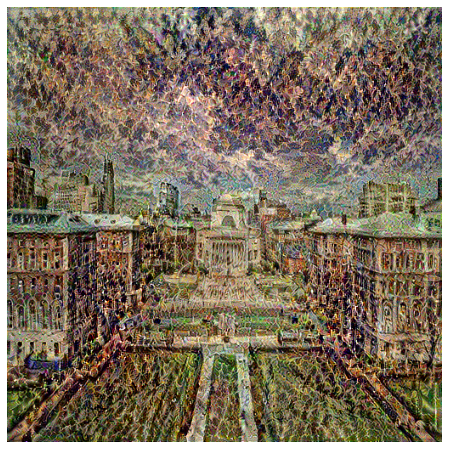

In [34]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-15)

### Examples that don't work as well

(-0.5, 511.5, 511.5, -0.5)

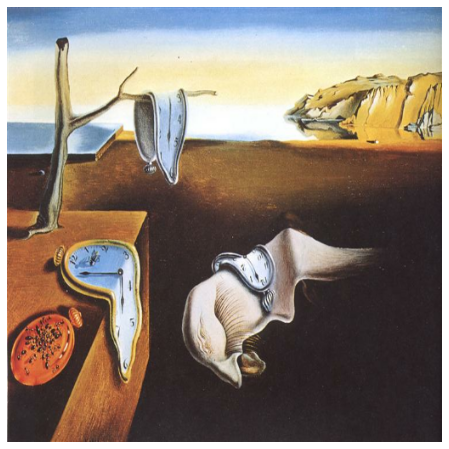

In [35]:
dali = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Dali.jpg')
plt.figure(figsize = (8, 8))
plt.imshow(dali.numpy())
plt.axis('off')

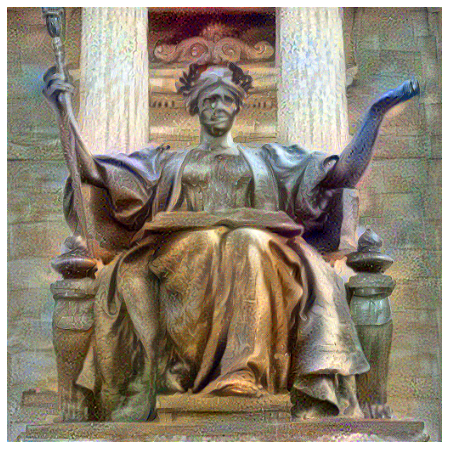

In [36]:
target = vgg19_neural_style_transfer(almamater, dali,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

(-0.5, 511.5, 511.5, -0.5)

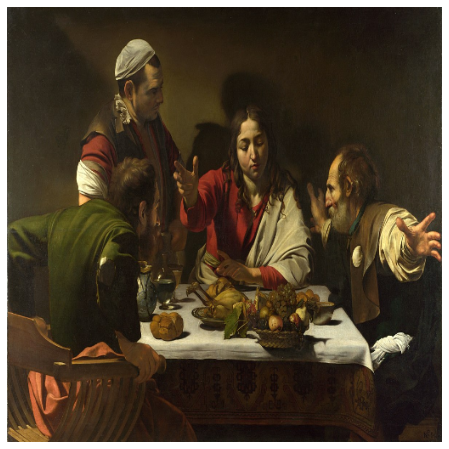

In [37]:
caravaggio = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Caravaggio.jpg')
plt.figure(figsize = (8, 8))
plt.imshow(caravaggio.numpy())
plt.axis('off')

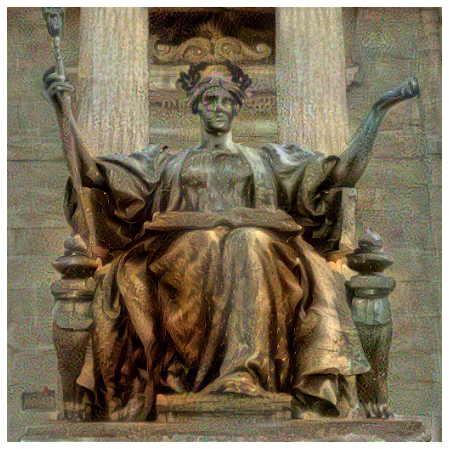

In [38]:
target = vgg19_neural_style_transfer(almamater, caravaggio,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)